## Let's explore our music files and see how they actually look

In [1]:
from scipy.io import wavfile
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure

In [2]:
def show_sound_wave(middle_c,title=None):
    """
    General function to display a sound way plot
    """
    figure(figsize=(8, 6), dpi=80)
    plt.plot(middle_c)
    plt.xlabel('Time')
    plt.ylabel('Amplitude')
    if title==None:
        plt.title('Sound wave')
    else:
        plt.title(title)
    plt.grid()
    plt.show()

## Comparing sounds with their amplitude:

### Sad Tunes:

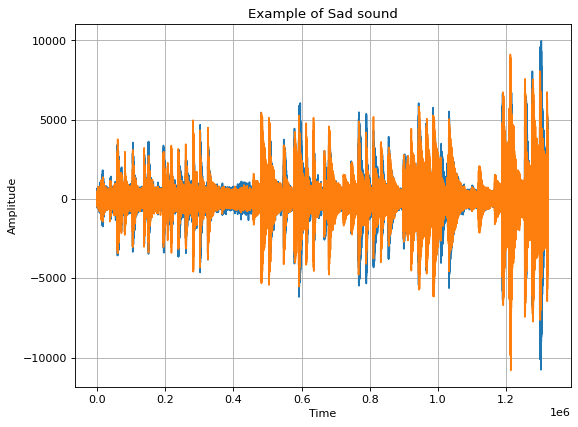

In [3]:
sample_rate, middle_c = wavfile.read('../all_wav/sad/sad_5.wav')
show_sound_wave(middle_c,'Example of Sad sound')

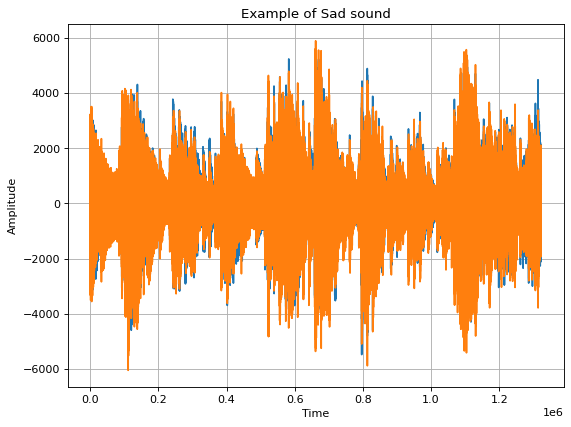

In [4]:
sample_rate, middle_c = wavfile.read('../all_wav/sad/sad_18.wav')
show_sound_wave(middle_c,'Example of Sad sound')

### Happy Sounds:

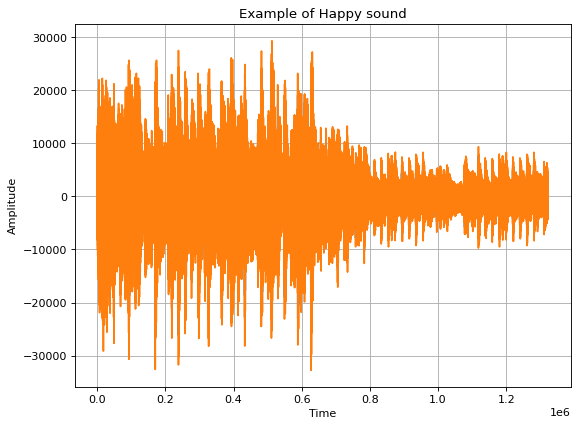

In [5]:
sample_rate, middle_c = wavfile.read('../all_wav/happy/happy_1.wav')
show_sound_wave(middle_c,'Example of Happy sound')

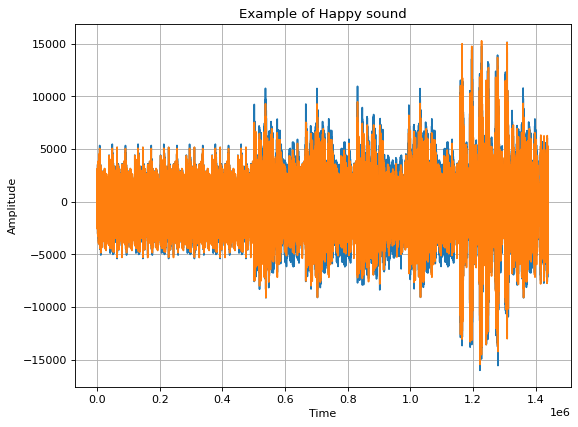

The sample rate is 48000


In [6]:
sample_rate, middle_c = wavfile.read('../all_wav/happy/happy_25.wav')
show_sound_wave(middle_c,'Example of Happy sound')
print("The sample rate is {}".format(sample_rate))

#### We can observe that the happy sounds in general have a higher amplitude than sad sounds

### The industry standard nowadays use Librosa to do the EDA of audio.
#### This is because it normalizes the audio wave output and makes sure to keep the audio under 22khz and in a mono channel

In [7]:
import IPython.display as ipd
import librosa
import librosa.display
import numpy as np

In [44]:
def wave_show(data,sample_rate):
    """
    General function to display a wave using librosa
    """
    plt.figure(figsize=(20,5))
    librosa.display.waveshow(data,sr=sample_rate)
    print("The sample rate is {}".format(sample_rate))
    

def plot_spectograms(list_data,list_sample_rate):
    """
    Specific function to plot 3 spectograms given the data and their sample rate
    """
    fig, (ax1,ax2,ax3) = plt.subplots(1,len(list_data),figsize=(9,6))
    librosa.display.specshow(librosa.power_to_db(librosa.feature.melspectrogram(y=list_data[0], sr=list_sample_rate[0], n_mels=128,
                                         fmax=8000), ref=np.max), x_axis='time',
                              y_axis='mel', sr=list_sample_rate[0],
                              fmax=8000, ax=ax1)
    librosa.display.specshow(librosa.power_to_db(librosa.feature.melspectrogram(y=list_data[1], sr=list_sample_rate[1], n_mels=128,
                                         fmax=8000), ref=np.max), x_axis='time',
                              y_axis='mel', sr=list_sample_rate[1],
                              fmax=8000, ax=ax2)
    librosa.display.specshow(librosa.power_to_db(librosa.feature.melspectrogram(y=list_data[2], sr=list_sample_rate[2], n_mels=128,
                                         fmax=8000), ref=np.max), x_axis='time',
                              y_axis='mel', sr=list_sample_rate[2],
                              fmax=8000, ax=ax3)

### Plotting a Sad Tune:

The sample rate is 22050


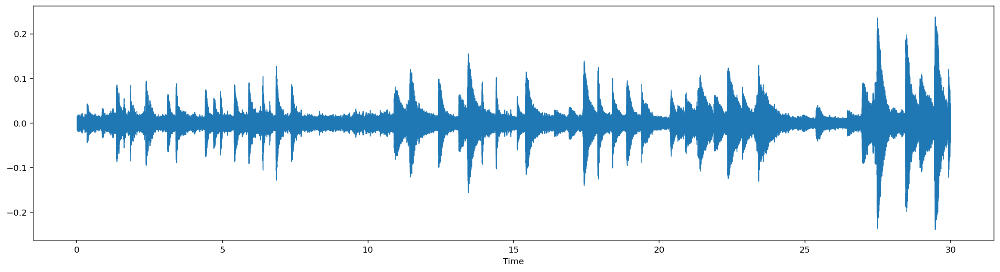

In [45]:
filename='../all_wav/sad/sad_5.wav'
data,sample_rate=librosa.load(filename)
wave_show(data,sample_rate)
ipd.Audio(filename)

In [46]:
def prepare_spectograms(path,name):
    """
    General function to prepare and plot 3 spectograms from a given path and genre
    """
    list_data=[]
    list_sample_rate=[]
    for i in ['1.wav','2.wav','3.wav']:
        data,sr=librosa.load(path+name+'_'+i)
        list_data=list_data+[data]
        list_sample_rate=list_sample_rate+[sr]
    plot_spectograms(list_data,list_sample_rate)

### Plotting a Happy Tune:

The sample rate is 22050


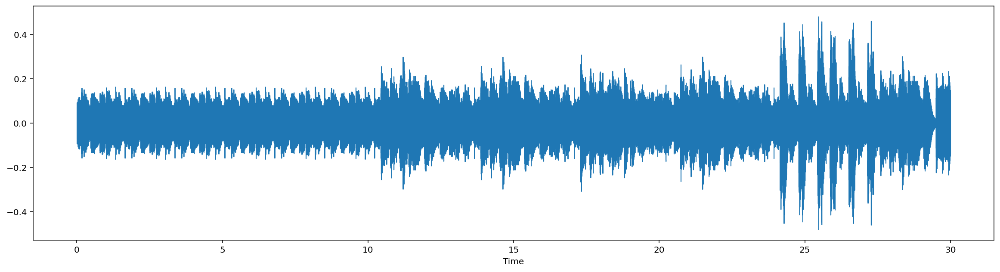

In [47]:
filename='../all_wav/happy/happy_25.wav'
data,sample_rate=librosa.load(filename)
wave_show(data,sample_rate)
ipd.Audio(filename)

### Spectrograms for Sad Tunes:

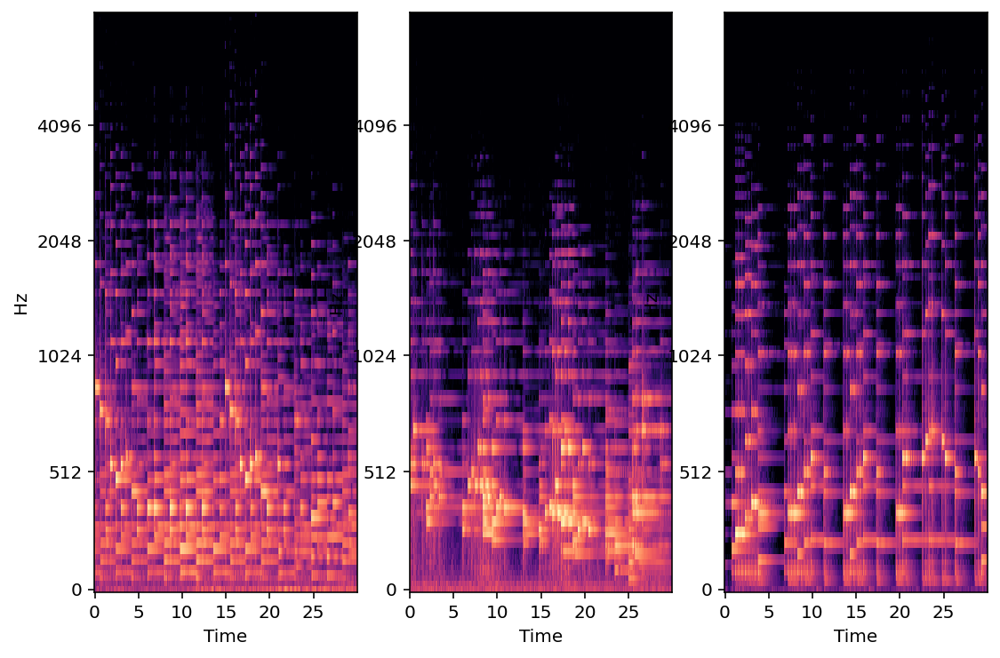

In [49]:
prepare_spectograms("../all_wav/sad/","sad")

### Spectrogram for Happy Tunes:

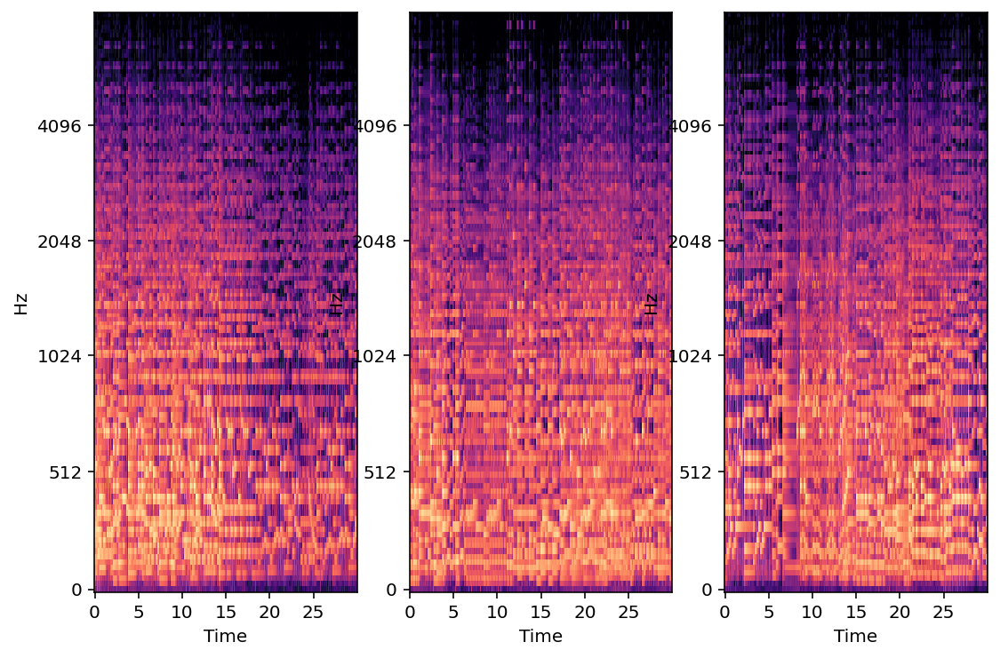

In [50]:
prepare_spectograms("../all_wav/happy/","happy")

### Scipy audio note representation vs Libroasa:

In [25]:
middle_c

array([[ 267,   51],
       [ 293,   82],
       [ 293,   92],
       ...,
       [ 342, -272],
       [ 734, -161],
       [1036,  -58]], dtype=int16)

In [26]:
data

array([ 0.00372283,  0.00619581,  0.00302696, ..., -0.01619891,
       -0.0102347 ,  0.00880123], dtype=float32)

### Example of a Mystery tune:

The sample rate is 22050


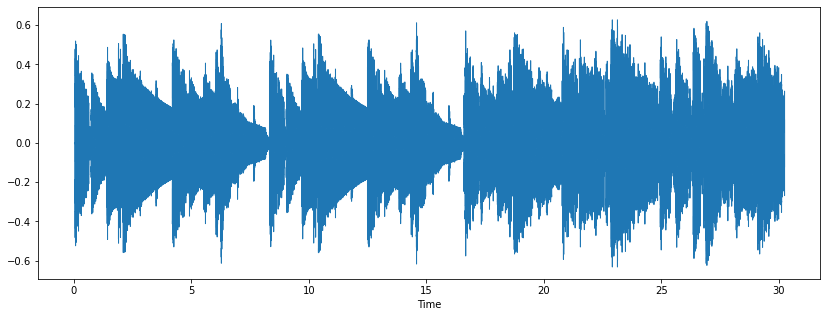

In [27]:
filename='../all_wav/horror_mystery_thriller/mystery_13.wav'
data,sample_rate=librosa.load(filename)
wave_show(data,sample_rate)
ipd.Audio(filename)

### As discussed, we will be using midi file format of tunes. Let us use that to analyse:

In [28]:
from music21 import converter, instrument, note, chord, midi

In [29]:
filename='../final_tunes_midi/Misery/sad_11.mid'


In [30]:
def find_midi_stream(filename):
    """
    General function to find the stream of a midi tune
    """
    obj = midi.MidiFile()
    obj.open(filename)
    obj.read()
    obj.close()
    streamer = midi.translate.midiFileToStream(obj)
    return streamer

In [31]:
op=find_midi_stream(filename)
op.show('midi')

In [32]:
def find_notes_chords(filename):
    """
    General function to find the notes and chords 
    """
    m = converter.parse(filename)
    instrument_notes = 0
    try:
        instruments = instrument.partitionByInstrument(m)
        instrument_notes = instruments.parts[0].recurse() 
    except:
        instrument_notes = midi.flat.notes

    notes=[]
    chords=[]
    for i in instrument_notes:
        if isinstance(i, note.Note):
            notes.append(str(i.pitch))
        elif isinstance(i, chord.Chord):
            notes.append('.'.join(str(n) for n in i.normalOrder))
    return notes

In [33]:
notes_and_chords=find_notes_chords(filename)

In [34]:
print(notes_and_chords)

['8.0', 'C5', 'E-4', 'B-4', 'B-3', 'D4', 'G4', 'B-2', 'B-3', 'G3', 'B-4', 'E-4', 'C3', 'B-4', 'G3', 'D4', 'C4', 'B-4', 'E-4', 'E-2', 'D4', 'B-4', 'B-2', '2.7', 'B-4', 'G#2', 'E-3', 'G3', 'G#3', 'C4', 'E-4', 'G#4', 'B-2', 'F3', 'G3', 'B-3', 'D4', 'F4', 'B-4', 'C3', 'B-4', 'G3', 'B-3', 'D4', 'E-4', 'G4', 'C5', 'E-2', 'D4', 'G4', 'C5', 'B-2', 'E-3', 'G3', 'D4', 'E-4', 'G4']
